In [1]:
import numpy as np
import xarray as xr
import uxarray as ux
import spatialpandas as sp
import spatialpandas.dask 

import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import rasterize
import geoviews as gv
import geoviews.feature as gf
import datashader as ds
import datashader.transfer_functions as tf

import hvplot.pandas
import hvplot.xarray  
import hvplot.dask

from matplotlib import cm
import cartopy.crs as ccrs

import os, sys

In [2]:
# Relative Path for PolyMesh
%load_ext autoreload
%autoreload 2

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path + "/polymesh")

from polymesh import Polymesh as Polymesh

# NOAA-Geoflow Data

In [3]:
# GeoFlow Small (6,000 faces)
base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/small/"

ugrid_small = ux.open_dataset(base_path + "grid.nc",
                              base_path + "v1.000000.nc",
                              base_path + "v2.000000.nc",
                              base_path + "v3.000000.nc")

# GeoFlow Large (6,000,0000 faces)
base_path = "/glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/large/"

ugrid_large = ux.open_dataset(base_path + "grid.nc",
                              base_path + "v1.000000.nc",
                              base_path + "v2.000000.nc",
                              base_path + "v3.000000.nc")

Loading initial grid from file:  /glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/small/grid.nc
Loading initial grid from file:  /glade/p/cisl/vast/vapor/data/Source/UGRID/NOAA-geoflow/large/grid.nc


# Mesh Construction

In [8]:
%%time
projection = ccrs.Robinson()
geoflow_small = Polymesh(ugrid=ugrid_small, projection=projection)
geoflow_small.construct_mesh()

CPU times: user 15 ms, sys: 10 µs, total: 15 ms
Wall time: 47 ms


In [9]:
%%time
projection = ccrs.Robinson()
geoflow_large = Polymesh(ugrid=ugrid_large, projection=projection)
geoflow_large.construct_mesh()

CPU times: user 11.1 s, sys: 673 ms, total: 11.8 s
Wall time: 12.2 s


#  Visualization

In [10]:
hv.output(size=400)
cmap = cm.coolwarm

## Single Plot (Static, Raster)

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]
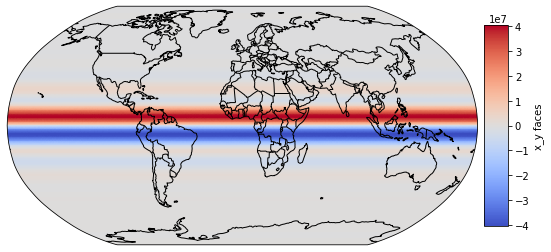

In [11]:
hvplot.extension('matplotlib')

# Specify Data Variable and Dimensions for Plotting
df = geoflow_large.data_mesh(name="v3", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

# Use hvPlot and geoviews  to create a rasterized plot with geographic features
v3_t0_mL0_l = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v3_t0_mL0_l

## Single Plot (Static, No Raster)

:Overlay
   .Polygons.I  :Polygons   [x,y]   (faces)
   .Coastline.I :Feature   [Longitude,Latitude]
   .Borders.I   :Feature   [Longitude,Latitude]
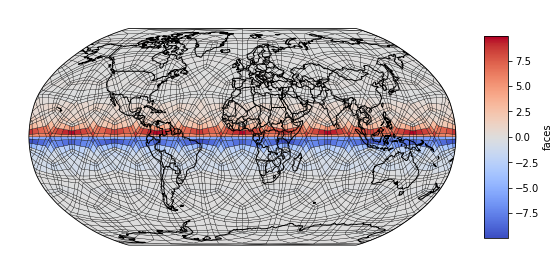

In [13]:
hvplot.extension('matplotlib')

# Specify Data Variable and Dimensions for Plotting
df = geoflow_small.data_mesh(name="v3", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

# Use hvPlot and geoviews  to create a rasterized plot with geographic features
v3_t0_mL0_l = df.hvplot.polygons(rasterize=False,aggregator='mean', c='faces', cmap=cmap, lw=0.3) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v3_t0_mL0_l

## Single Plot (Interactive)

In [8]:
hvplot.extension('bokeh')

# Specify Data Variable and Dimensions for Plotting
df = geoflow_large.data_mesh(name="v3", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

# Use hvPlot and geoviews  to create a rasterized plot with geographic features
v3_t0_mL0_l = df.hvplot.polygons(rasterize=True, project=False, aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v3_t0_mL0_l

:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]

## Raster vs No Raster (Small Dataset)

CPU times: user 170 ms, sys: 2.98 ms, total: 173 ms
Wall time: 245 ms


:Layout
   .DynamicMap.I :DynamicMap   []
      :Overlay
         .Image.I     :Image   [x,y]   (x_y faces)
         .Coastline.I :Feature   [Longitude,Latitude]
         .Borders.I   :Feature   [Longitude,Latitude]
   .Overlay.I    :Overlay
      .Polygons.I  :Polygons   [x,y]   (faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]
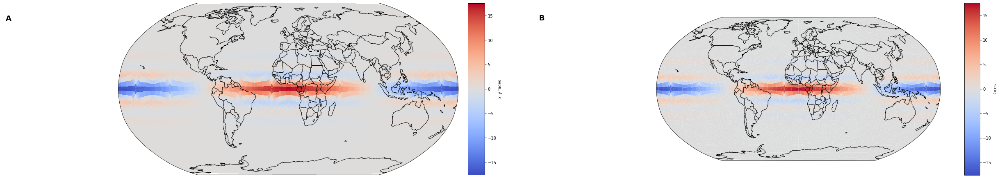

In [19]:
%%time
hvplot.extension('matplotlib')

df = geoflow_small.data_mesh(name="v1", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")
v1_t0_mL0_s_raster = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)
v1_t0_mL0_s_noraster = df.hvplot.polygons(rasterize=False,aggregator='mean', c='faces', cmap=cmap, lw=0.0) * gf.coastline(projection=projection) * gf.borders(projection=projection)

v1_t0_mL0_s_raster + v1_t0_mL0_s_noraster

## Grid Visualization

""

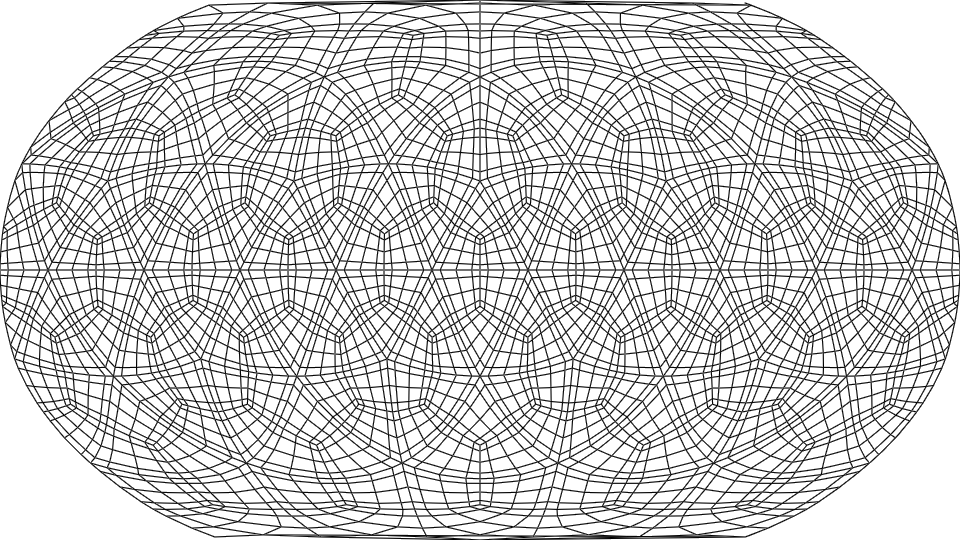

In [79]:
# Select any data variable
df = geoflow_small.data_mesh(name="v1", dims={"time" : 0, "meshLayers" : 0}, fill="nodes")

cvs = ds.Canvas(plot_width=960, plot_height=540)
agg = cvs.line(df, geometry='geometry', agg=ds.any(), line_width=0.5)
outline = tf.shade(agg, cmap='black')
grid = tf.Images(outline)
grid